In [2]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os

Matplotlib created a temporary cache directory at /scratch/vscott/job_39289457/matplotlib-q9hoil4f because the default path (/home/jovyan/.cache/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.


In [3]:
#get data from Ingrid
base_path = "../ialtamirano/raw_data/WESAD"
Question_Dir = base_path
Quest_Out_CSV = "./all_questionnaires.csv"

#load CSV file into a df
quest_df = pd.read_csv("all_questionnaires.csv")


 Exploratory Data Analysis for: **PANAS**
------------------------------------------------------------
PANAS_Active         | min: 1, Q1: 1.0, median: 2.0, Q3: 3.0, max: 5
PANAS_Distressed     | min: 1, Q1: 1.0, median: 1.0, Q3: 2.0, max: 4
                       ↪ Outliers: [4, 4]
PANAS_Interested     | min: 1, Q1: 2.0, median: 3.0, Q3: 4.0, max: 5
PANAS_Inspired       | min: 1, Q1: 1.0, median: 2.0, Q3: 3.0, max: 5
PANAS_Annoyed        | min: 1, Q1: 1.0, median: 1.0, Q3: 1.0, max: 5
                       ↪ Outliers: [3, 2, 2, 2, 2, 5, 3, 2, 2, 2, 2]
PANAS_Strong         | min: 1, Q1: 1.0, median: 2.0, Q3: 3.0, max: 4
PANAS_Guilty         | min: 1, Q1: 1.0, median: 1.0, Q3: 1.0, max: 3
                       ↪ Outliers: [2, 3, 2, 3, 2]
PANAS_Scared         | min: 1, Q1: 1.0, median: 1.0, Q3: 2.0, max: 5
                       ↪ Outliers: [4, 5, 4]
PANAS_Hostile        | min: 1, Q1: 1.0, median: 1.0, Q3: 1.0, max: 4
                       ↪ Outliers: [2, 2, 4, 3, 2]
PANAS_Excited    

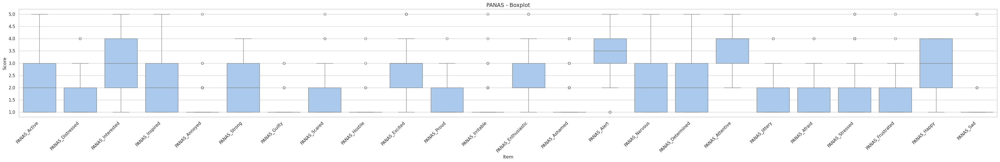

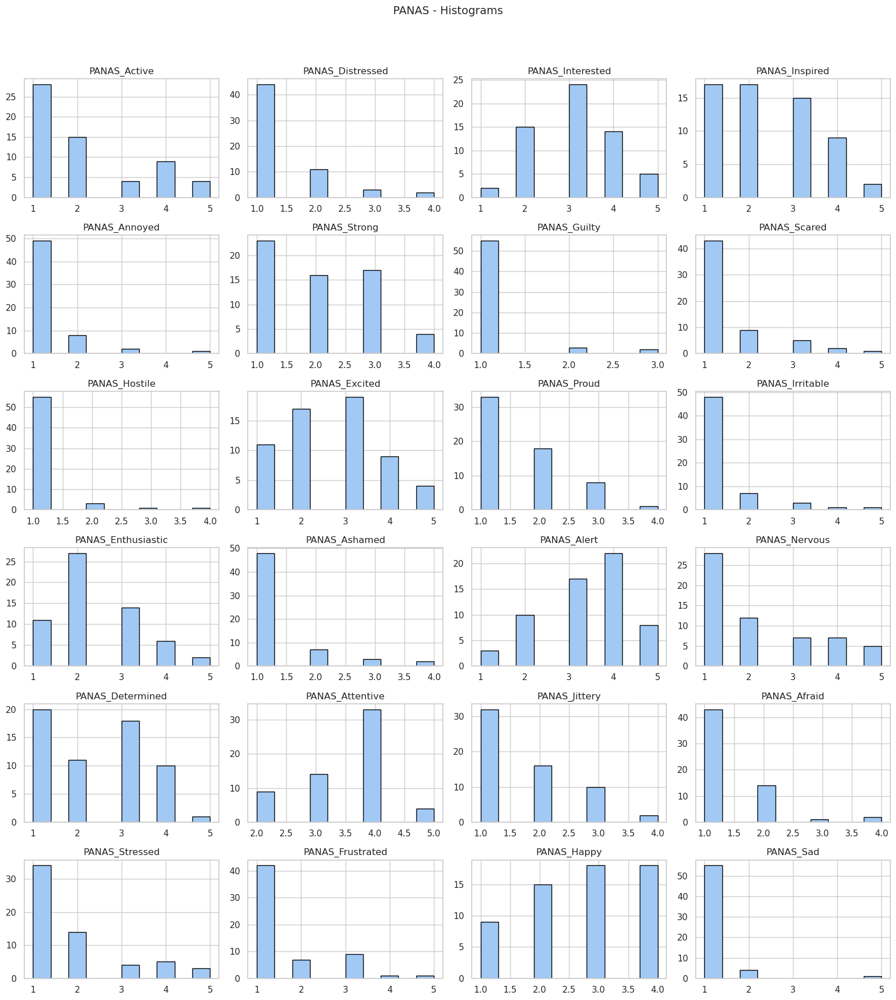

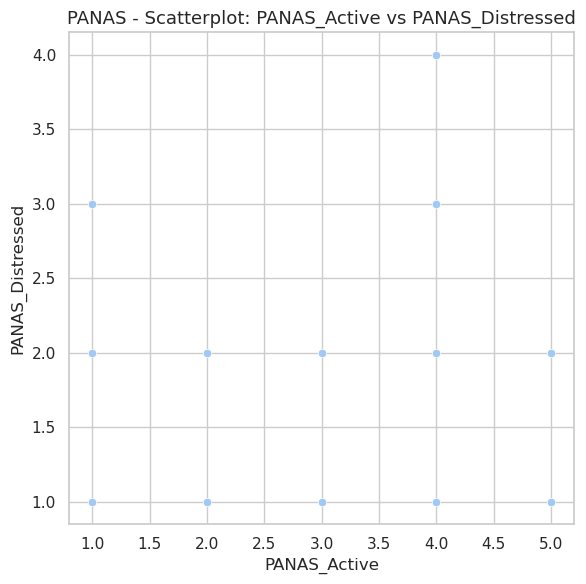


 Exploratory Data Analysis for: **STAI**
------------------------------------------------------------
STAI_I_feel_at_ease  | min: 1, Q1: 1.75, median: 3.0, Q3: 4.0, max: 4
STAI_I_feel_nervous  | min: 1, Q1: 1.0, median: 1.0, Q3: 2.0, max: 4
                       ↪ Outliers: [4, 4, 4, 4, 4]
STAI_I_am_jittery    | min: 1, Q1: 1.0, median: 1.5, Q3: 2.0, max: 3
STAI_I_am_relaxed    | min: 1, Q1: 2.0, median: 3.0, Q3: 4.0, max: 4
STAI_I_am_worried    | min: 1, Q1: 1.0, median: 1.0, Q3: 2.0, max: 4
                       ↪ Outliers: [4]
STAI_I_feel_pleasant | min: 1, Q1: 1.75, median: 2.0, Q3: 3.0, max: 4
------------------------------------------------------------


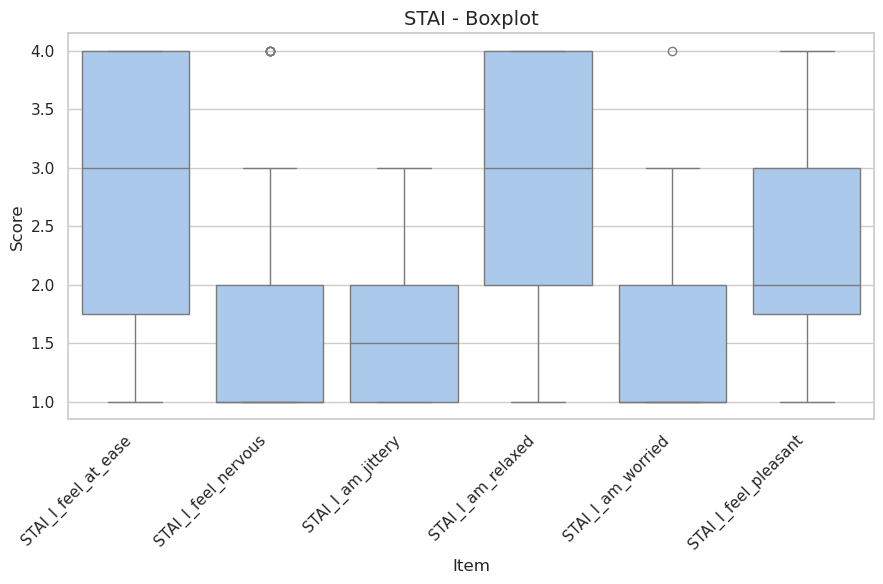

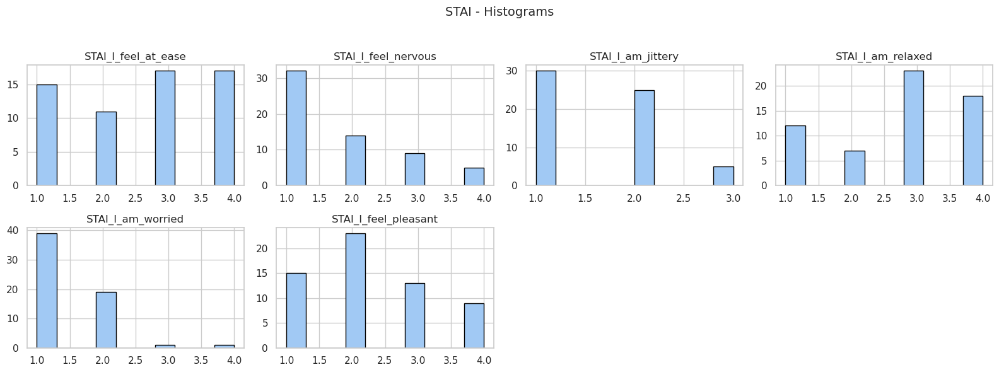

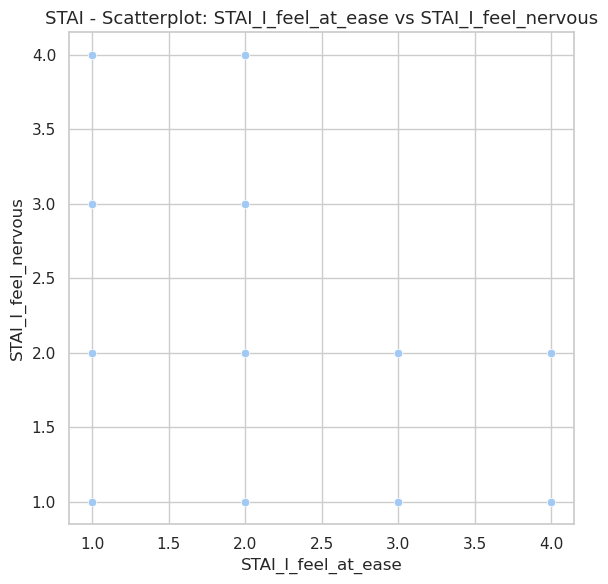


 Exploratory Data Analysis for: **SAM**
------------------------------------------------------------
SAM_Valence          | min: 1, Q1: 5.75, median: 7.0, Q3: 7.0, max: 9
                       ↪ Outliers: [3, 3, 3, 1, 9]
SAM_Arousal          | min: 1, Q1: 2.0, median: 3.0, Q3: 5.0, max: 9
------------------------------------------------------------


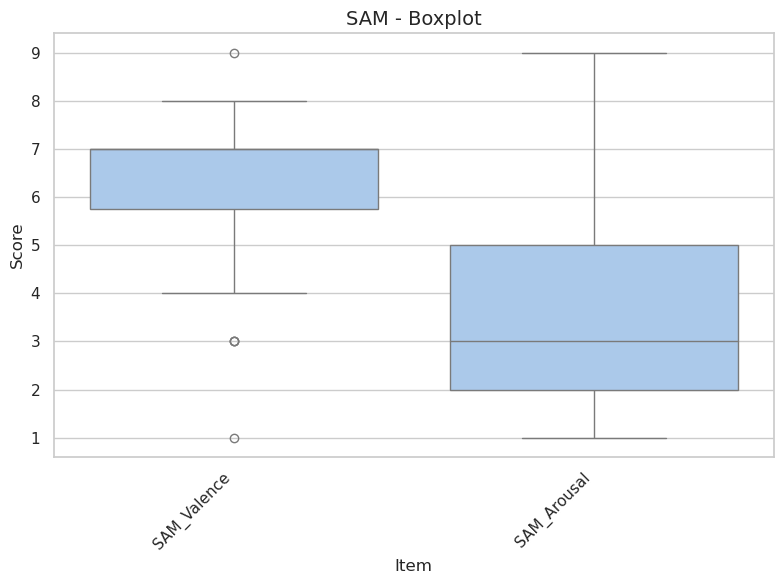

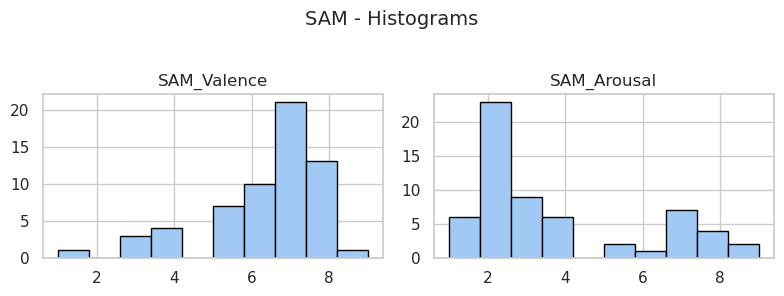

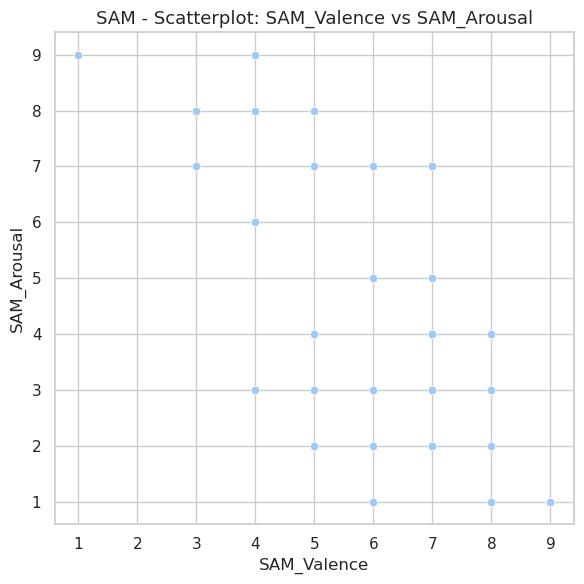


 Exploratory Data Analysis for: **SSSQ**
------------------------------------------------------------
SSSQ_Committed_to_goals | min: 3.0, Q1: 3.0, median: 4.0, Q3: 4.0, max: 5.0
SSSQ_Wanted_to_succeed | min: 2.0, Q1: 4.0, median: 4.0, Q3: 5.0, max: 5.0
                       ↪ Outliers: [2.0]
SSSQ_Motivated       | min: 1.0, Q1: 4.0, median: 4.0, Q3: 4.0, max: 5.0
                       ↪ Outliers: [2.0, 5.0, 5.0, 1.0, 3.0, 5.0]
SSSQ_Reflected_about_self | min: 2.0, Q1: 3.0, median: 4.0, Q3: 4.0, max: 5.0
SSSQ_Worried_about_others | min: 2.0, Q1: 3.0, median: 3.0, Q3: 4.0, max: 5.0
SSSQ_Concerned_about_impression | min: 1.0, Q1: 2.5, median: 4.0, Q3: 4.5, max: 5.0
------------------------------------------------------------


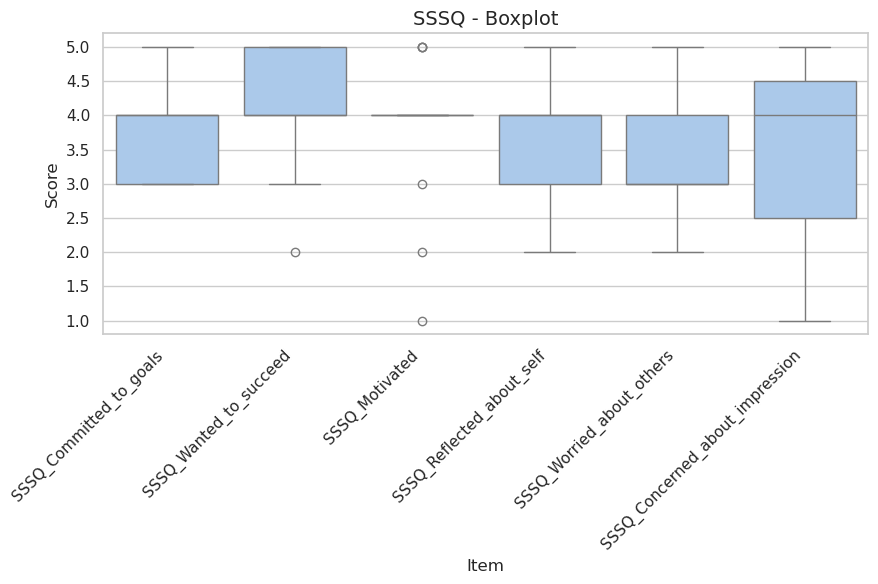

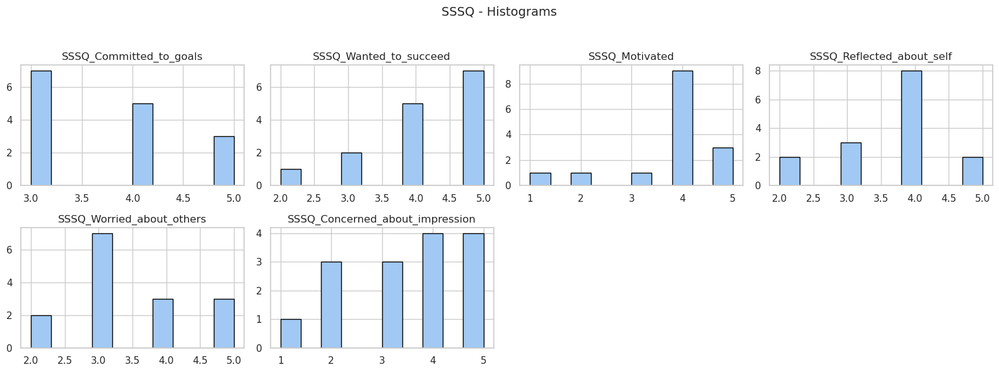

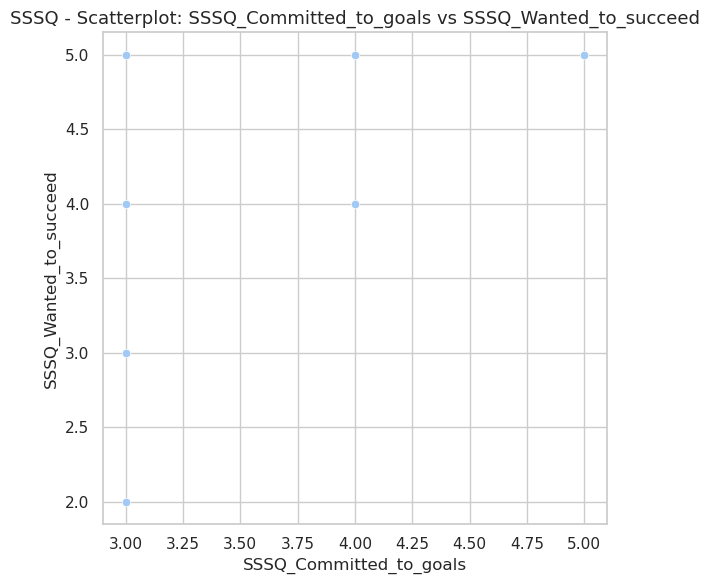

In [4]:
sns.set(style='whitegrid', palette='pastel')

def five_number_summary(series):
    return {
        'min': round(series.min(), 2),
        'Q1': round(series.quantile(0.25), 2),
        'median': round(series.median(), 2),
        'Q3': round(series.quantile(0.75), 2),
        'max': round(series.max(), 2)
    }

def identify_outliers(series):
    q1 = series.quantile(0.25)
    q3 = series.quantile(0.75)
    iqr = q3 - q1
    lower = q1 - 1.5 * iqr
    upper = q3 + 1.5 * iqr
    return series[(series < lower) | (series > upper)]

def full_eda_on_measure(df, measure_prefix, output_dir="eda_outputs"):
    os.makedirs(output_dir, exist_ok=True)

    measure_cols = [col for col in df.columns if col.startswith(measure_prefix)]
    measure_df = df[measure_cols].copy()
    melted = measure_df.melt(var_name='Item', value_name='Score')

    print(f"\n Exploratory Data Analysis for: **{measure_prefix}**")
    print("-" * 60)

    summary_data = []
    outlier_data = []

    for col in measure_cols:
        clean_series = df[col].dropna()
        summary = five_number_summary(clean_series)
        outliers = identify_outliers(clean_series)

        summary_data.append({'Item': col, **summary})
        if not outliers.empty:
            for val in outliers:
                outlier_data.append({'Item': col, 'Outlier': round(val, 2)})

        summary_str = ', '.join([f"{k}: {v}" for k, v in summary.items()])
        print(f"{col:20} | {summary_str}")
        if not outliers.empty:
            print(f"{' ' * 22} ↪ Outliers: {list(np.round(outliers.dropna().values, 2))}")
    print("-" * 60)

    #summary to CSV
    summary_df = pd.DataFrame(summary_data)
    summary_df.to_csv(os.path.join(output_dir, f"{measure_prefix}_summary.csv"), index=False)

    if outlier_data:
        outlier_df = pd.DataFrame(outlier_data)
        outlier_df.to_csv(os.path.join(output_dir, f"{measure_prefix}_outliers.csv"), index=False)

    #bxplt
    plt.figure(figsize=(max(8, len(measure_cols)*1.5), 6), dpi=100)
    sns.boxplot(data=melted, x='Item', y='Score')
    plt.xticks(rotation=45, ha='right')
    plt.title(f"{measure_prefix} - Boxplot", fontsize=14)
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, f"{measure_prefix}_boxplot.png"))
    plt.show()

    #histogrm
    n_cols = min(len(measure_cols), 4)
    n_rows = int(np.ceil(len(measure_cols) / n_cols))
    measure_df.hist(bins=10, figsize=(n_cols * 4, n_rows * 3), layout=(n_rows, n_cols), edgecolor='black')
    plt.suptitle(f"{measure_prefix} - Histograms", fontsize=14)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.savefig(os.path.join(output_dir, f"{measure_prefix}_histograms.png"))
    plt.show()

    #scttrplt
    if len(measure_cols) >= 2:
        plt.figure(figsize=(6, 6), dpi=100)
        sns.scatterplot(x=measure_df[measure_cols[0]], y=measure_df[measure_cols[1]])
        plt.xlabel(measure_cols[0])
        plt.ylabel(measure_cols[1])
        plt.title(f"{measure_prefix} - Scatterplot: {measure_cols[0]} vs {measure_cols[1]}", fontsize=13)
        plt.grid(True)
        plt.tight_layout()
        plt.savefig(os.path.join(output_dir, f"{measure_prefix}_scatterplot.png"))
        plt.show()

    #heatmaps
    corr = measure_df.corr()
    plt.figure(figsize=(30, 60), dpi=1000)
    sns.heatmap(corr, annot=True, cmap='coolwarm', fmt=".2f", square=True, cbar_kws={'shrink': 0.8})
    plt.title(f"{measure_prefix} - Correlation Heatmap", fontsize=8)
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, f"{measure_prefix}_correlation_heatmap.png"))
    plt.show()

#EDA run all
for measure in ['PANAS', 'STAI', 'SAM', 'SSSQ']:
    full_eda_on_measure(quest_df, measure)


In [5]:
pip install reportlab

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [7]:
'''from reportlab.lib.pagesizes import letter
from reportlab.platypus import SimpleDocTemplate, Paragraph, Spacer, Image, PageBreak
from reportlab.lib.styles import getSampleStyleSheet
import os

def generate_eda_pdf_report(measure_list, output_dir="eda_outputs", output_file="EDA_Report.pdf"):
    doc = SimpleDocTemplate(output_file, pagesize=letter)
    styles = getSampleStyleSheet()
    elements = []

    for measure in measure_list:
        elements.append(Paragraph(f"Exploratory Data Analysis - {measure}", styles['Heading1']))
        elements.append(Spacer(1, 12))

        #summ txt
        summary_path = os.path.join(output_dir, f"{measure}_summary.csv")
        if os.path.exists(summary_path):
            summary_df = pd.read_csv(summary_path)
            elements.append(Paragraph("Five-Number Summary:", styles['Heading2']))
            for _, row in summary_df.iterrows():
                text = f"{row['Item']}: min={row['min']}, Q1={row['Q1']}, median={row['median']}, Q3={row['Q3']}, max={row['max']}"
                elements.append(Paragraph(text, styles['Normal']))
            elements.append(Spacer(1, 12))

        # outlier txt
        outliers_path = os.path.join(output_dir, f"{measure}_outliers.csv")
        if os.path.exists(outliers_path):
            outliers_df = pd.read_csv(outliers_path)
            elements.append(Paragraph("Outliers:", styles['Heading2']))
            for item in outliers_df['Item'].unique():
                out_vals = outliers_df[outliers_df['Item'] == item]['Outlier'].tolist()
                elements.append(Paragraph(f"{item}: {out_vals}", styles['Normal']))
            elements.append(Spacer(1, 12))

        # plt img
        for plot_type in ['boxplot', 'histograms', 'scatterplot', 'correlation_heatmap']:
            img_path = os.path.join(output_dir, f"{measure}_{plot_type}.png")
            if os.path.exists(img_path):
                elements.append(Paragraph(f"{measure} - {plot_type.replace('_', ' ').title()}", styles['Heading2']))
                elements.append(Image(img_path, width=500, height=300))
                elements.append(Spacer(1, 24))

        elements.append(PageBreak())

    doc.build(elements)
    print(f" PDF report saved as: {output_file}")

generate_eda_pdf_report(['PANAS', 'STAI', 'SAM', 'SSSQ'])'''


DecompressionBombError: 
fileName='eda_outputs/PANAS_correlation_heatmap.png' identity=[ImageReader@0x155521993190 filename='eda_outputs/PANAS_correlation_heatmap.png'] Image size (1800000000 pixels) exceeds limit of 178956970 pixels, could be decompression bomb DOS attack.

In [15]:
import os
import pandas as pd

# cond vs measure columns
condition_col = quest_df.columns[1]       
measure_cols = quest_df.columns[2:]       
conditions = quest_df[condition_col].dropna().unique()

#folder for summ stat
output_dir = "summary_stats_by_condition"
os.makedirs(output_dir, exist_ok=True)

#save for each cond
for cond in conditions:
    cond_df = quest_df[quest_df[condition_col] == cond]
    summary_stats = cond_df[measure_cols].describe().T

    #save as file inside folder
    safe_cond = str(cond).replace(" ", "_").replace("/", "-")
    output_file = os.path.join(output_dir, f"summary_{safe_cond}.csv")
    
    summary_stats.to_csv(output_file)

print(f"Summary statistics saved in: {output_dir}")


Summary statistics saved in: summary_stats_by_condition
